# Generative model for images :
# **Pseudoinverse-Guided Diffusion Models for inverse problems : $\Pi$GDM**


# Download files:

In [1]:
!git clone https://github.com/DPS2022/diffusion-posterior-sampling.git
!cp -r diffusion-posterior-sampling/guided_diffusion guided_diffusion
!wget -nc -O ffhq256-1k-validation.zip 'https://www.dropbox.com/scl/fi/pppstbdsf0em6o0qscruc/ffhq256-1k-validation.zip?rlkey=xl7nwv2nxb6yvsirr3wad77hm'
!unzip -nq ffhq256-1k-validation.zip
!wget -nc -O ffhq_10m.pt 'https://www.dropbox.com/scl/fi/pq72vxzxcbygieq5z4gvf/ffhq_10m.pt?rlkey=5sxdj6r4o9f7b7bbp5fxg2f5r'
!wget https://perso.telecom-paristech.fr/aleclaire/mva/tpdeblur.zip
!unzip tpdeblur.zip

Cloning into 'diffusion-posterior-sampling'...
remote: Enumerating objects: 82, done.
remote: Total 82 (delta 0), reused 0 (delta 0), pack-reused 82 (from 1)
Receiving objects: 100% (82/82), 16.19 MiB | 17.09 MiB/s, done.
Resolving deltas: 100% (30/30), done.
--2024-12-12 08:41:31--  https://www.dropbox.com/scl/fi/pppstbdsf0em6o0qscruc/ffhq256-1k-validation.zip?rlkey=xl7nwv2nxb6yvsirr3wad77hm
Resolving www.dropbox.com (www.dropbox.com)... 162.125.2.18, 2620:100:6017:18::a27d:212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.2.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://uce0badabf3413dba1a3ac9db070.dl.dropboxusercontent.com/cd/0/inline/CgFExDUVlv1TgDa6ObGkITL83z3Q9V-2AGy8oRtzURa2ZghahcpyxpfEsXJzQPc1OM8rK9LWtwqnnKK2fhw_pgRuT5s6GUtwpMStiBOy2BiPc3gqOM4bzCsDYjOOXq06pOc/file# [following]
--2024-12-12 08:41:32--  https://uce0badabf3413dba1a3ac9db070.dl.dropboxusercontent.com/cd/0/inline/CgFExDUVlv1TgDa6ObGkITL83z3Q9V-2AGy8oRtzURa2Zghahcp

In [2]:
import torch
import torchvision
import numpy as np
from torch.fft import fft2, ifft2, fftshift, ifftshift

import matplotlib.pyplot as plt

from PIL import Image
from tqdm import tqdm
from guided_diffusion.unet import create_model
device = "cuda:0" if torch.cuda.is_available() else "cpu"
from abc import ABC, abstractmethod
#device = "cpu"
print("Device:", device)

Device: cuda:0


# Display functions
We will work with PyTorch images with color values in $[-1,1]$ and the usual additional batch dimension.
Images will have size 1x3x256x256 in PyTorch.

Image 00800


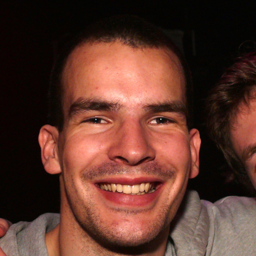

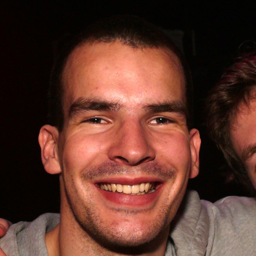

In [3]:
def pilimg_to_tensor(pil_img):
  t = torchvision.transforms.ToTensor()(pil_img)
  t = 2*t-1 # [0,1]->[-1,1]
  t = t.unsqueeze(0)
  t = t.to(device)
  return(t)

def display_as_pilimg(t):
  t = 0.5+0.5*t.to('cpu')
  t = t.squeeze()
  t = t.clamp(0.,1.)
  pil_img = torchvision.transforms.ToPILImage()(t)
  display(pil_img)
  return(pil_img)

idx = np.random.randint(1000)
print('Image', str(idx).zfill(5))
img_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
display(img_pil)
display_as_pilimg(pilimg_to_tensor(img_pil));

# Load DDPM Unet

In [4]:
# Load model
model_config = {'image_size': 256,
                'num_channels': 128,
                'num_res_blocks': 1,
                'channel_mult': '',
                'learn_sigma': True,
                'class_cond': False,
                'use_checkpoint': False,
                'attention_resolutions': 16,
                'num_heads': 4,
                'num_head_channels': 64,
                'num_heads_upsample': -1,
                'use_scale_shift_norm': True,
                'dropout': 0.0,
                'resblock_updown': True,
                'use_fp16': False,
                'use_new_attention_order': False,
                'model_path': 'ffhq_10m.pt'}
model = create_model(**model_config)
model = model.to(device)
# use in eval mode:
model.eval();

/content/guided_diffusion/unet.py:88: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(th.load(model_path, map_location='cpu'))


- VP-SDE and VE-SDE formalism.

In VP-SDE formalism, the scheme takes the form : $\mathbf x_{t + 1}^{VP} = \sqrt{\alpha}_t\mathbf x_t^{VP} + \sqrt{1 - \alpha_t}\epsilon_t$.
With such a model, one can see that it leads to the following law :
$$
q(\mathbf x_t^{VP}|x_0) \sim \mathcal{N}(\sqrt{\bar\alpha}_t x_0, (1 - \bar{\alpha}_t)\mathbf{I})
$$
where $\mathbf {\bar \alpha}_t = \prod_{i = 0}^{t - 1} \alpha_i$. Otherwise stated :
$$
x_t^{VP} = \sqrt{\bar \alpha_t}\mathbf x_0 + \sqrt{1 - \bar{\alpha}_t}\epsilon
$$
With Tweedie's formulas, it is easy to show that :
$$
\hat{x}_0^{VP}(\mathbf x_t) = \frac{1}{\sqrt{\bar{\alpha}_t}} \mathbf x_t^{VP}
- \sqrt{\frac{1}{\bar{\alpha}_t}-1} \;  \varepsilon_t(\mathbf x_t^{VP}, t).
$$
In the VE-SDE formalism, one has :
$$
\mathbf x_{t + 1}^{VE} = \mathbf x_t^{VE} + \sigma_t' \epsilon_t
$$
Similarly, it is easy to show that a direct consequence is :
$$
q(\mathbf x_t^{VE}|\mathbf x_0) \sim \mathcal{N}(\mathbf x_0, \sum_{i = 1}^{t - 1} \sigma_i'^2 \mathbf{I})
$$
It also hint the following schema :
$$
\mathbf x_t^{VE} = \mathbf x_0 + \sqrt{\sum_{i = 1}^{t - 1} \sigma_i'^2} \epsilon
$$
which immediately leads to
$$
\hat{\mathbf x}^{VE}_0(\mathbf x_t) = \mathbf x_t^{VE} + \sigma_t^2 \nabla_{\mathbf{x}_t}\log(p_t(\mathbf{x}_t^{VE})) \approx \mathbf x_t^{VE} - \sigma_t \epsilon_{\theta}(\mathbf{x}_t^{VE}, \sigma_t)
$$
Thus, noting $\sigma_t^2 = \sum_{i  = 1}^{t - 1}\sigma_i'^2$, one can see a correspondance between the two descriptions : $\sigma_t = \sqrt{\frac{1 - \bar{\alpha}_t}{\bar \alpha_t}}$ et $\mathbf x_t^{VE} = \displaystyle\frac{\mathbf x_t^{VP}}{\sqrt{\bar \alpha_t}}$. They are the same, up to a factor $\sqrt{\bar\alpha_t}$. That's why according to the paper, a scale factor of $\sqrt{\bar \alpha_t}$ appear in front of the guidance term.

In the paper $\Pi GDM$, it  was at first not present because it was the VE-SDE scheme. It is then precised that, in practice, it is always the VP-SDE scheme that is employed, and consequently, the guidance term derived in the first part of the paper need the $\sqrt{\bar \alpha_t}$ additional term.

# PIGuidance class

The PIGuidance class defined below will be used to sample the PIGuidance class.

The Unet ```model``` estimates the residual noise $\varepsilon_t(\mathbf x_t, t)$ from a noisy image $(\mathbf x_t, t)$.

The method ```get_eps_from_model(self, x, t)``` computes $\varepsilon_t(\mathbf x_t, t)$.

The method ```predict_xstart_from_eps(self, x, eps, t)``` in VP-SDE formalism computes

$$
\hat{\mathbf x}_0(\mathbf x_t) = \frac{1}{\sqrt{\bar{\alpha}_t}} \mathbf x_t
- \sqrt{\frac{1}{\bar{\alpha}_t}-1} \;  \varepsilon_t(\mathbf x_t, t).
$$

Among the attributes of the class, there is:
* `self.num_diffusion_timesteps` : $T$
* `self.reversed_time_steps` : backward $t$ range:  $\{T, T-1, \ldots, 1\}$
* `self.betas` : $(\beta_t)_{1 \leq t \leq T}$
* `self.alphas` : $(\alpha_t)_{1 \leq t \leq T}$
* `self.alphas_cumprod` : $(\bar{\alpha}_t)_{1 \leq t \leq T}$
* `self.alphas_cumprod_prev` : $(\bar{\alpha}_{t-1})_{1 \leq t \leq T}$

In the noisy case, we will choose, accordingly to the paper,
$$
r_t = \sqrt{\frac{\sigma_t^2}{1 + \sigma_t^2}}
$$
or in terms of $\bar\alpha_t$ :
$$
r_t = \sqrt{1 - \bar \alpha_t}
$$
The algorithm employed is the following:


In [5]:
def downsampling(x):
    return x[:,:,::s,::s]

def upsampling(y):
    upsample1 = torch.nn.Upsample(scale_factor=s)
    output1 = upsample1(y)
    return output1

def linear_operator_sup_res(x):
    return downsampling(ifft2(bf*fft2(x)).real)

def linear_operator_sup_res_pinv(y):
    x = upsampling(y)
    return ifft2(bf*fft2(x)).real

In [6]:
sigma_noise = 2*10/255

def mypsnr(x,y):
  error = torch.mean((x-y)**2).item()
  psnr = 10*np.log10(2**2/error)
  return(psnr)

class Operator(ABC):
    """Base class for operator"""
    def __init__(self, linear):
      self.linear = linear #Tell if an operator is linear or not

    @abstractmethod
    def forward(self, x):
      pass

    @abstractmethod
    def pseudo_inverse(self, x):
      pass

class super_resolution(Operator):
  """Super-resolution operator"""
  def __init__(self, bf, stride = 1):
    Operator.__init__(self, True)
    self.stride = stride
    self.bf = bf

  def downsampling(self, x):
      return x[:,:,::self.stride,::self.stride]

  def upsampling(self, y):
      upsample1 = torch.nn.Upsample(scale_factor=self.stride)
      output1 = upsample1(y)
      return output1

  def forward(self, x):
      return self.downsampling(ifft2(self.bf*fft2(x)).real)

  def pseudo_inverse(self, y):
      x = self.upsampling(y)
      return ifft2(self.bf*fft2(x)).real

class quantization(Operator):
  """Quantization operator"""
  def __init__(self, scale = 1):
    Operator.__init__(self, False)
    self.scale = scale

  def forward(self, x):
    return torch.floor(x*self.scale)

  def pseudo_inverse(self, z):
    return z/self.scale

class blurring(Operator):
  """Blurring operator"""
  def __init__(self, kernel):
    Operator.__init__(self, True)
    self.kernel = kernel
    self.fk = fft2(kernel).to(device).real

  def forward(self, x):
    return ifft2(self.fk*fft2(x)).real

  def pseudo_inverse(self, x):
    fk_conj = torch.conj(self.fk)
    return ifft2(fk_conj*fft2(x)/torch.abs(self.fk)**2).real

class masking(Operator):
  """masking operator"""
  def __init__(self, mask):
    Operator.__init__(self, linear = True)
    self.mask = mask

  def forward(self, x):
    return self.mask * x

  def pseudo_inverse(self, x):
    return self.forward(x)

class concat_operator(Operator):
  """Class to encode a composition of operator"""
  def __init__(self, nb_operator, list_operator):
    self.nb_operator = nb_operator
    self.list_operator = list_operator

  def forward(self, x):
    for operator in self.list_operator:
      x = operator.forward(x)
    return x

  def pseudo_inverse(self, x):
    for operator in self.list_operator[::-1]:
      x = operator.pseudo_inverse(x)
    return x

class PIGuidance_VP:
  def __init__(self, model=model):

    self.num_diffusion_timesteps = 1000
    self.reversed_time_steps = np.arange(self.num_diffusion_timesteps)[::-1]
    beta_start = 0.0001
    beta_end = 0.01
    self.eta = 1

    self.betas = np.linspace(beta_start, beta_end, self.num_diffusion_timesteps,
                              dtype=np.float64)
    self.alphas = 1.0 - self.betas
    self.alphas_cumprod = np.cumprod(self.alphas, axis=0)
    self.alphas_cumprod_prev = np.append(1.0, self.alphas_cumprod[:-1])
    self.model = model
    self.sigma_y = 0
    self.imgshape = (1,3,256,256)

    self.best_result = None

  def get_eps_from_model(self, x, t):
    # the model outputs:
    # - an estimation of the noise eps (chanels 0 to 2, one per color)
    # - learnt variances for the posterior  (chanels 3 to 5)
    # (see Improved Denoising Diffusion Probabilistic Models
    # by Alex Nichol, Prafulla Dhariwal
    # for the parameterization)
    # We discard the second part of the output for this practice session.
    model_output = self.model(x, torch.tensor(t, device=device).unsqueeze(0))
    model_output = model_output[:,:3,:,:]
    return(model_output)

  def predict_xstart_from_eps(self, x, eps, t):
    x_start = (
        np.sqrt(1.0 / self.alphas_cumprod[t])* x
        - np.sqrt(1.0 / self.alphas_cumprod[t] - 1) * eps
    )
    x_start = x_start.clamp(-1.,1.)
    return(x_start)

  def posterior_sampling(self, y, operator, name, x_true=None, show_steps=True, vis_y=None, scale = 5):
    """
    Apply the Pseudo-Inverse guidance algorithm to compute the backward
    differential equation
    Args :
      linear_operator : function which compute H
      linear_operator_pinv : function which compute the pseudo-inverse of  H
      y : measurement of x_0
      name : string saying which operator is used
      scale  : parameter for quantization operator
    """

    # visualization image for the observation y:
    if vis_y==None:
      vis_y = y

    # initialize xt for t=T
    x = torch.randn(self.imgshape,device=device)
    x.requires_grad = True
    psnr_noisy = [0]
    psnr_denoised = [0]
    for i,t in enumerate(self.reversed_time_steps[:-1]):

      #estimating the noise
      eps = self.get_eps_from_model(x,t)
      #eps = torch.zeros(x.shape).to(device)

      #compute x_start
      x_start = self.predict_xstart_from_eps(x,eps,t)

      c1 = self.eta*np.sqrt((1 - self.alphas_cumprod[t]/self.alphas_cumprod[t - 1])*(1 - self.alphas_cumprod[t - 1])/(1 - self.alphas_cumprod[t]))

      c2 = np.sqrt(1 - self.alphas_cumprod[t - 1] - (c1)**2)

      #if self.sigma_y == 0:
      mat = operator.pseudo_inverse(y)
      mat -= operator.pseudo_inverse(operator.forward(x_start))
      mat_x = torch.sum(torch.flatten(mat.detach())*torch.flatten(x_start))
      guidance = torch.autograd.grad(mat_x,x)[0]

      norm = 1/torch.linalg.norm(guidance)

      #direct computation from eps
      #posterior_mean = 1/np.sqrt(self.alphas[t])*(x - self.betas[t]/np.sqrt(1 - self.alphas_cumprod[t])*eps)

      #Noise
      noise = torch.randn_like(x)

      #posterior sampling correction
      x = np.sqrt(self.alphas_cumprod[t - 1])*x_start + c1*noise + c2*eps + guidance*np.sqrt(self.alphas_cumprod[t])*norm

      mypsnr_noise = mypsnr(x,x_true)
      mypsnr_st = mypsnr(x_start,x_true)

      if mypsnr_st > max(psnr_denoised):
        self.best_result = x_start

      psnr_noisy += [mypsnr_noise]
      psnr_denoised += [mypsnr_st]

      if show_steps:
        if i%200==99 or t==10 or i==0:
          print('Iteration :', i, 't=', t)
          pilimg = display_as_pilimg(torch.cat((x,x_start), dim = 3))
          pilimg.save('PiGuidance_posterior_sample_iter_'+name+str(i).zfill(4)+'.png')
    return(x, psnr_noisy, psnr_denoised)

PIGuidance = PIGuidance_VP()

<br/><br/><br/>

<br/><br/><br/>

We will perform pseudoinverse guidance for linear inverse problems based on

*PSEUDOINVERSE-GUIDED DIFFUSION MODELS
FOR INVERSE PROBLEMS*,<br/>
by Jiaming Song, Arash Vahdat, Morteza Mardani, Jan Kautz,<br/>
ICLR 2023, https://openreview.net/pdf?id=9_gsMA8MRKQ

We restrict to linear measurements with Gaussian noise (eg inpainting, super-resolution, deblurring,...).

Given
$\mathbf{y} = H \mathbf x + \eta$ where $H$ is a linear operator and $\eta$ is some Gaussian additive noise, we want to compute
$$
p_t(\mathbf y|\mathbf{x_t}) = \int_{\mathbf{x_0}}p_t(\mathbf{x_0}|\mathbf x_t)p_t(\mathbf y|\mathbf x_0) dx_0.
$$
The integral is intractable for at least two reasons: first $p_t(\mathbf{x_0}|\mathbf x_t)$ is intractable, and if it was the case, the integral itself can be very hard to estimate.

Note: one could be tempted to write $x_0 = x_t - \sigma_t^2\epsilon$, and deduce that $x_0 \sim \mathcal{N}(x_t, \sigma_t^2)$. This is of course wrong, because $\epsilon$ and $x_t$ are **not** independant.

Hence, the paper proposes the following approximation :
$$
p_t(\mathbf{x}_0|\mathbf{x}_t) \sim \mathcal{N}(\hat{ \mathbf{x}}_0, r_t^2 \mathbf{I})
$$
with $\hat{\mathbf x}_0 = \mathbb{E}[\mathbf x_0 | \mathbf x_t] = \mathbf x_t + \sigma_t^2 \nabla_{\mathbf x_t}\log(p_t(\mathbf x_t))$. This is one of Tweedie's formula.
Since the measurement noise is also gaussian, one can then deduce from it that
$$
p_t(\mathbf y|\mathbf x_t) \sim \mathcal{N}(H\hat{\mathbf x}_0, r_t^2 H H^\top + \sigma_y \mathbf{I})
$$
The score then become very easy to compute :
$$
\nabla_{\mathbf x_t} \log_{\mathbf x_t}p_t(\mathbf y | \mathbf{x}_t) = \left((\mathbf y - H \hat{\mathbf x}_0)^\top(r_t^2HH^\top + \sigma_y^2 \mathbf{I})^{-1}H \frac{\partial \hat{\mathbf x}_0}{\partial \mathbf x_t}\right)^\top
$$
The jacobian $\displaystyle \frac{\partial \hat{ \mathbf x}_0}{\partial \mathbf x_t}$ will be computed thanks to brackpropagation gradient with pytorch autograd.

Things become interesting when one assume $\sigma_y = 0$, the above equation lets appear the pseudo-inverse
$$
\nabla_{\mathbf x_t} \log_{\mathbf x_t}p_t(\mathbf y | \mathbf x_t) = r_t^{-2}\left((H^†\mathbf y - H^†H \hat{\mathbf x}_0)^\top \displaystyle \frac{\partial \hat{\mathbf x}_0}{\partial \mathbf x_t} \right)^\top
$$
where $H^\dagger$ is the pseudo-inverse of the operator $H$ (see report for a proper definition), hence the name pseudo-inverse guidance.
This is performed by adding a guidance term to the sampling procedure. Like in the 6th lab, the network used for predicting the noise $\epsilon_\theta$ will be Unet. It was trained with the diffusion model (VP)-SDE, so we will naturally choose this formalism from now on. (i.e use $\bar\alpha_t$ rather than $\sigma_t$). The algorithm is the following:

>  Input : $\mathbf y$, $h(\mathbf x)$, $\sigma_y$, $\mathbf x_t$, $\eta \in [0,1]$,
$\epsilon-\text{prediction-model}$, $(\bar\alpha_t)_{t \in [0,T]}$
>
>  Initialize $\mathbf x_T$ as for unconditional sampling.
>
>  For $t=T$ to $1$:
>  1. $v_t \leftarrow t$, $v_s \leftarrow s$.
>  2. Predict the noise $\epsilon_{\theta}(\mathbf{x}_t,t)$ with Unet.
>  3. Predict $\hat{\mathbf x}_0(\mathbf x_t,t) = \frac{\mathbf x_t - \sqrt{1 - \bar\alpha_t}\epsilon_\theta}{\bar\alpha_t}$.
>  4. $c_1 = \eta \sqrt{(1 - \frac{\bar \alpha_t}{\bar \alpha_s})(\frac{1 - \bar\alpha_s}{1 - \bar\alpha_t})}$
>  5. $c_2 = \sqrt{1 - \bar\alpha_s - c_1^2}$
>  6. If $\sigma_y = 0$:
>     $$g = \left((h^\dagger(\mathbf y) - h^\dagger(h(\hat{\mathbf x}_0))^\top\frac{\partial \hat{\mathbf x}_0}{\partial \mathbf x}\right)^\top$$
>     else : (then it must be linear case)
>       $$r_t^2 = 1 - \bar \alpha_t$$
>       $$g = \left((\mathbf y - H \hat{\mathbf x}_0)^\top(r_t^2HH^\top + \sigma_y^2 \mathbf{I})^{-1}H \frac{\partial \hat{\mathbf x}_0}{\partial \mathbf x_t}\right)^\top$$

> 7. Sample $\epsilon$ from $\mathcal{N}(0,\mathbf{I})$.
> 8. $\mathbf x = \sqrt{\bar \alpha_s} \hat{\mathbf x}_0 + c_1\epsilon + c_2\epsilon_{\theta} + \sqrt{\bar \alpha_t}g$.

### Example of operators $H$

- Mask

In the case of mask operator, it is obvious that $H^\dagger = H$, so the score is very easy to compute :
$$
\nabla_{\mathbf x_t} \log_{\mathbf x_t}p_t(\mathbf y | \mathbf x_t) = r_t^{-2}\left((H(\mathbf y -\hat{\mathbf x}_0))^\top \displaystyle \frac{\partial \hat{\mathbf x}_0}{\partial \mathbf x_t} \right)^\top
$$

and in the noisy case:
$$
\nabla_{\mathbf x_t} \log_{\mathbf x_t}p_t(\mathbf y | \mathbf x_t) = \left((\mathbf y - H \hat{\mathbf x}_0)^\top(r_t^2H + \sigma_y^2 \mathbf{I})^{-1}H \frac{\partial \hat{\mathbf x}_0}{\partial \mathbf x_t}\right)^\top
$$

- Blurring

In this case, $H$ is a $\mathbb{Z}^2$ convolution operator with kernel $k$, i.e $H\mathbf x = k \star \mathbf x$. In Fourier domain, it becomes much simpler $\widetilde{H{\mathbf x}} = \tilde{k} \tilde{\mathbf x}$. Since $HH^\top$ is invertible, one can compute the pseudo-inverse as : $H^\dagger = H^\top (HH^\top)^{-1}$. A very quick calculation convince us that $\widetilde{H^\top x} = \bar{\hat{k}} \hat{x} $

So in Fourier domain, the pseudo inverse reduces to :
$$
\widetilde{H^† \mathbf x} = \frac{\bar{\tilde k} \tilde{\mathbf x}}{|\tilde k|^2}
$$
where the bar denotes the conjugate and $\sim$ the Fourier transform. Since this convolution operator is actually invertible, one expects that $H^\dagger H = \mathbf{I}$ and therefore:
$$
\nabla_{\mathbf x_t} \log_{\mathbf x_t}p_t(\mathbf y | \mathbf x_t) = \left((H^†\mathbf y -\hat{\mathbf x}_0)^\top \displaystyle \frac{\partial \hat{\mathbf x}_0}{\partial \mathbf x_t} \right)^\top
$$

- Quantization

In this non-linear case, one set $h(x) = \lfloor x\rfloor, x \in \mathbb{R}^n$ and $h^†(z) = z$ for $z \in \mathbb{Z}^n$. It follows immediately $h(h^\dagger(h(x))) = \lfloor x \rfloor$. Since the images values are within $[0,1]$, taking the floor function immediately is of course irrelevant. To do it, I'll first multiply all pixels by $5$, apply the operator $h$, and then scale back by $5$ to recover it.

- Super-resolution

Super-resolution consists in applying a blur kernel via convolution, and then downsampling by a stride $s \in \mathbb{N}$. Thus, it will be noted $Hx = (k \star x)_⇓$. One can fathom it is necessary to introduce an inverse operator to subsampling, that is upsampling. Upsampling (naturally noted $_{⇑}$) will be computed as the continuation pixel-wise over a set large and long of $s$ pixels. For a visual explanation, please check out : https://medium.com/analytics-vidhya/downsampling-and-upsampling-of-images-demystifying-the-theory-4ca7e21db24a.

One easily observes that the operator $Gy = k' \star y_⇑$, where $\tilde{k}' = \tilde{k}^{-1}$  verifies $HGH = H$. This is actually enough to state that $G$ is a Moonre-Penrose pseudo-inverse of $H$ i.e $H^\dagger = G$.

Note: the kernel used will not be the same as the one for blurring. I am going to take the same one as in TP5 for inverse problem in super-resolution setting. It turns out that actually, $k'_{i,j} = k_{i,j}$, in our case (see figure).

### Mask

cuda:0
original image 00200.png


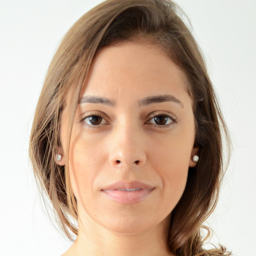

noisy measurement


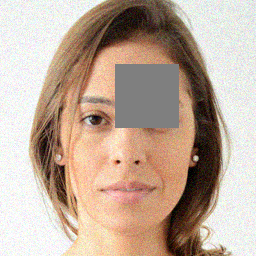

In [7]:
h = 256
w = 256
hcrop, wcrop = h//4, w//4
corner_top, corner_left = h//4, int(0.45*w)
#corner_top2, corner_left2 = h//8, int(0.8*w)
mask = torch.ones(PIGuidance.imgshape, device=device)
mask[:,:,corner_top:corner_top+hcrop,corner_left:corner_left+wcrop] = 0
#mask[:,:,corner_top2:corner_top2+hcrop,corner_left2:corner_left2+wcrop] = 0

idx = 200
x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
x_true_m = pilimg_to_tensor(x_true_pil)
print(x_true_m.device)
print("original image", str(idx).zfill(5)+'.png')
display_as_pilimg(x_true_m)

sigma_noise = 0.1

mask_operator = masking(mask)

y_mask = mask_operator.forward(x_true_m.clone()) + sigma_noise * mask * torch.randn_like(x_true_m)
print("noisy measurement")
display_as_pilimg(y_mask);

Iteration : 0 t= 999


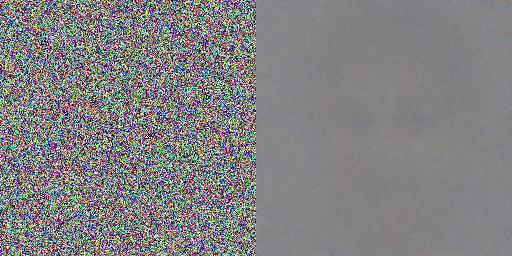

Iteration : 99 t= 900


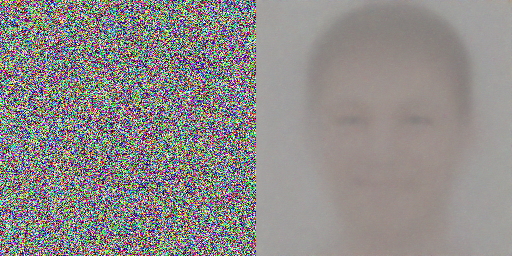

Iteration : 299 t= 700


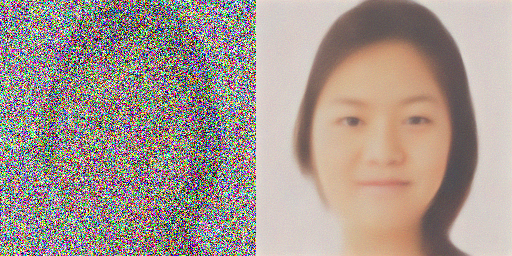

Iteration : 499 t= 500


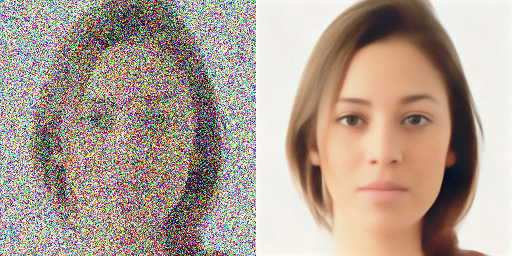

Iteration : 699 t= 300


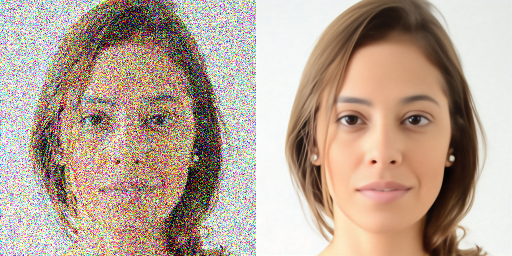

Iteration : 899 t= 100


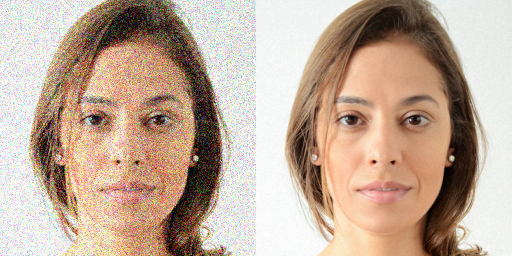

Iteration : 989 t= 10


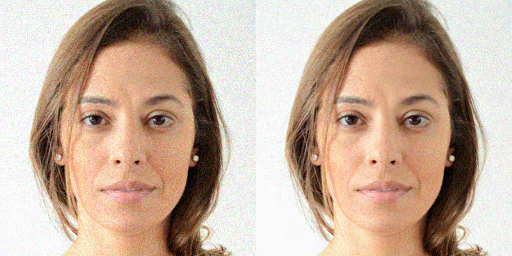

The best result is


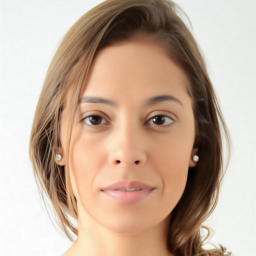

<PIL.Image.Image image mode=RGB size=256x256 at 0x7D85C9A1F9D0>


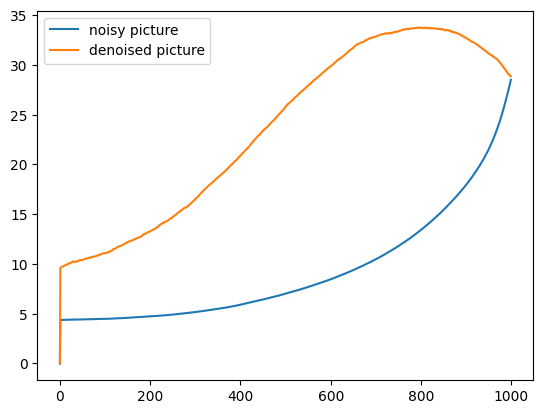

In [8]:
_,psnr_noisy, psnr_denoised = PIGuidance.posterior_sampling(y_mask, mask_operator, x_true=x_true_m, show_steps=True, name = "Mask")
plt.plot(psnr_noisy, label = 'noisy picture')
plt.plot(psnr_denoised, label = 'denoised picture')
plt.legend()

print("The best result is")
print(display_as_pilimg(PIGuidance.best_result))

### Blurring

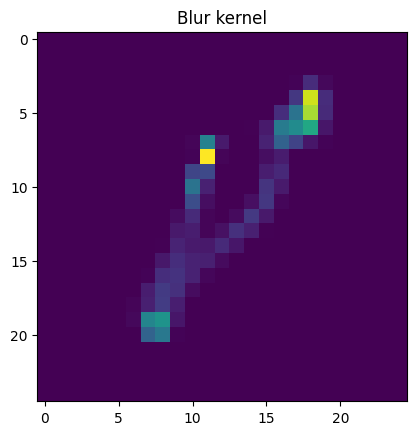

In [ ]:
# Load a blur kernel
kt = torch.tensor(np.loadtxt('kernels/kernel8.txt'))
# kt = np.loadtxt('kernels/levin7.txt')
(m,n) = kt.shape
plt.imshow(kt)
plt.title('Blur kernel')
plt.show()
kt = kt.to(device)

# Embed the kernel in a MxN image, and put center at pixel (0,0)
k = torch.zeros((256,256))
k[0:m,0:n] = kt/torch.sum(kt)
k = torch.roll(k,(-int(m/2),-int(n/2)),(0,1))
fk = fft2(k).to(device).real

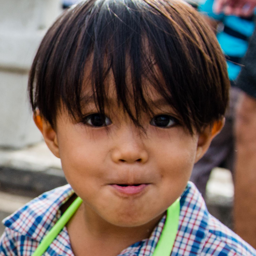

cuda:0
original image 00013.png


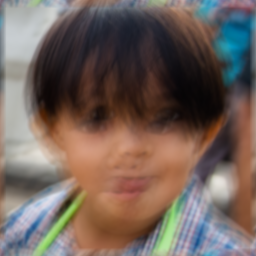

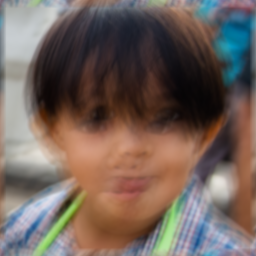

In [ ]:
idx = 13
x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
x_true_b = pilimg_to_tensor(x_true_pil).to(device)
display_as_pilimg(x_true_b)
print(x_true_b.device)
print("original image", str(idx).zfill(5)+'.png')
blur_operator = blurring(k)

y_blur = blur_operator.forward(x_true_b)
display_as_pilimg(y_blur)

Iteration : 0 t= 999


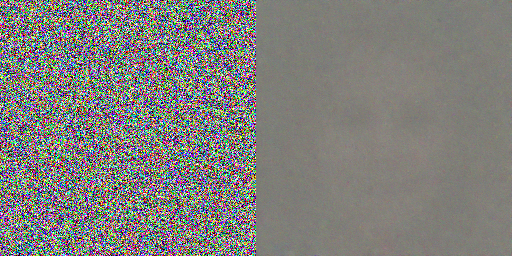

Iteration : 99 t= 900


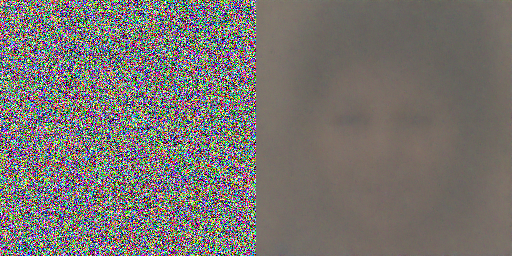

Iteration : 299 t= 700


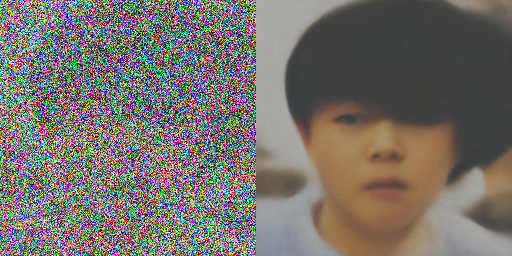

Iteration : 499 t= 500


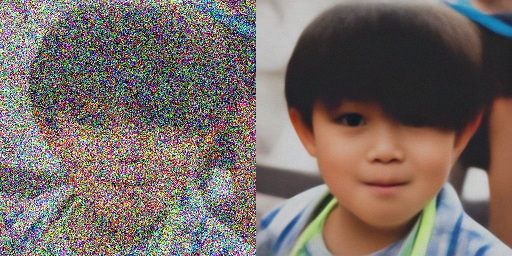

Iteration : 699 t= 300


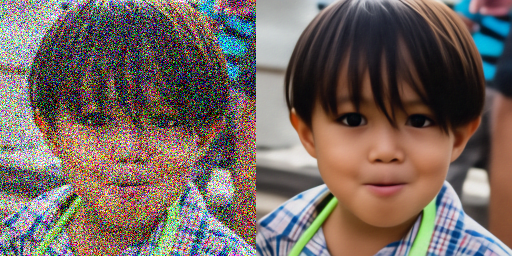

Iteration : 899 t= 100


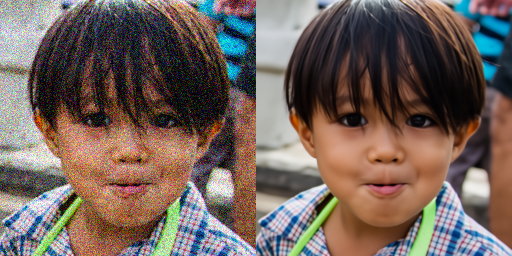

Iteration : 989 t= 10


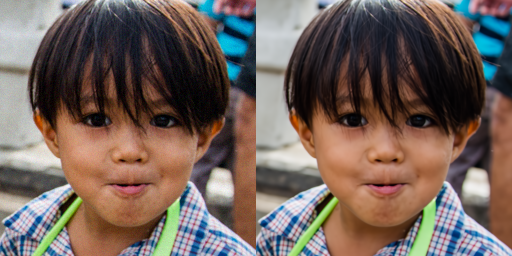

The best result is


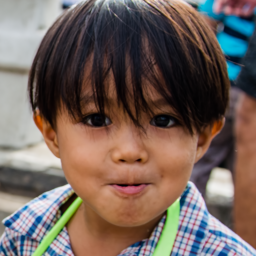

<PIL.Image.Image image mode=RGB size=256x256 at 0x7D7194AE6E30>


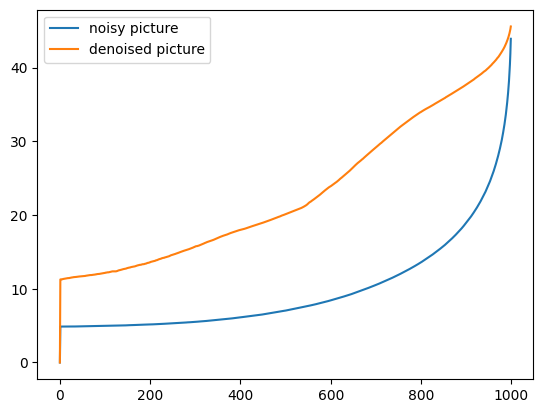

In [ ]:
_,psnr_noisy, psnr_denoised = PIGuidance.posterior_sampling(y_blur, blur_operator, x_true=x_true_b, show_steps=True, name = "blurring")
plt.plot(psnr_noisy, label = 'noisy picture')
plt.plot(psnr_denoised, label = 'denoised picture')
plt.legend()
print("The best result is")
print(display_as_pilimg(PIGuidance.best_result))

### Quantization

original image 00013.png


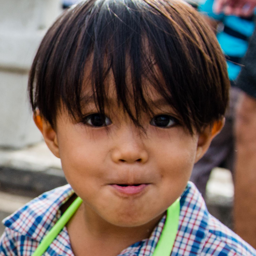

quantized image


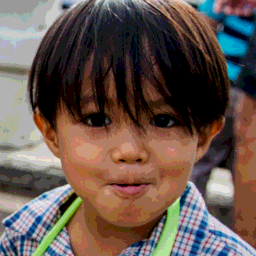

In [ ]:
idx = 13
scale = 5
x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
x_true_q = pilimg_to_tensor(x_true_pil).to(device)
print("original image", str(idx).zfill(5)+'.png')
display_as_pilimg(x_true_q)

quant = quantization(scale)

y_quant = quant.forward(x_true_q)
print("quantized image")
display_as_pilimg(y_quant/scale)
x_true_q /= scale

Iteration : 0 t= 999


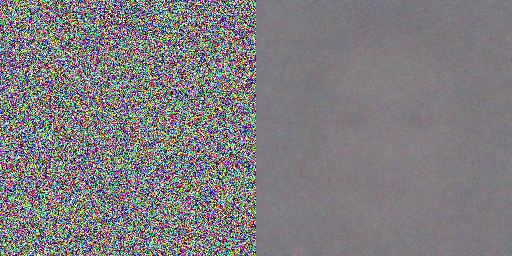

Iteration : 99 t= 900


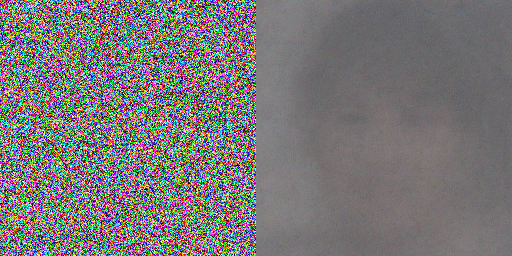

Iteration : 299 t= 700


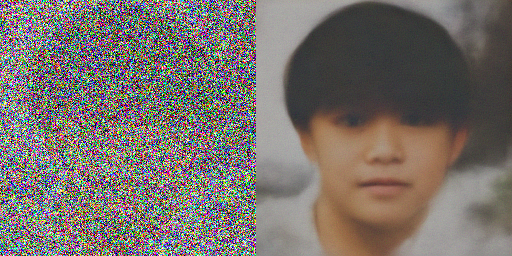

Iteration : 499 t= 500


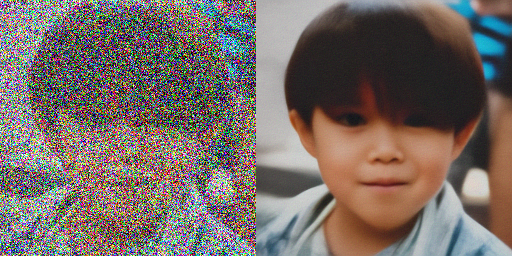

Iteration : 699 t= 300


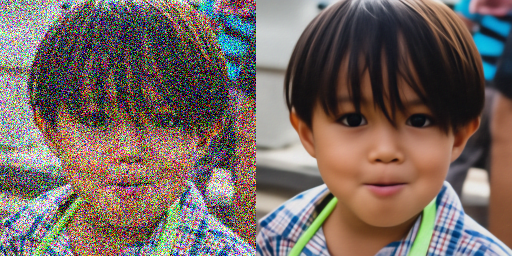

Iteration : 899 t= 100


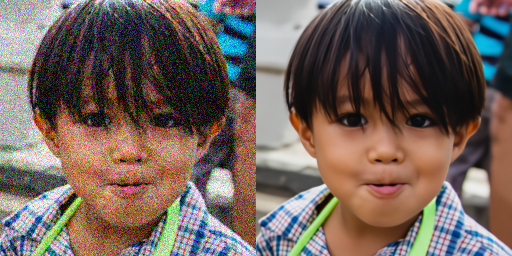

Iteration : 989 t= 10


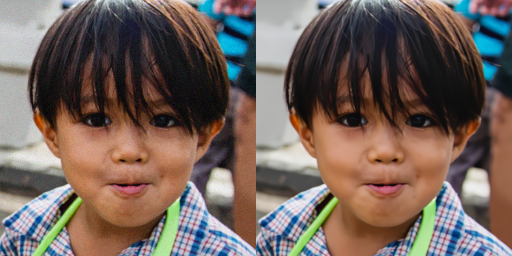

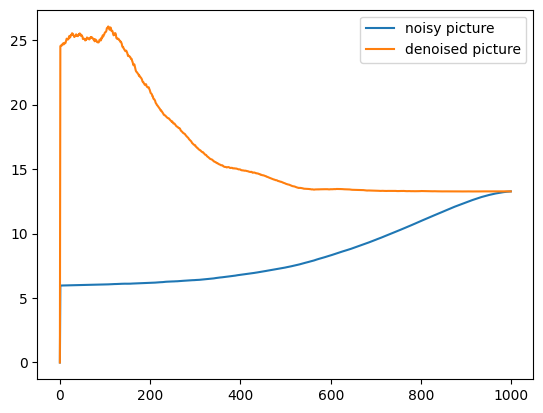

In [ ]:
_, psnr_noisy, psnr_denoised = PIGuidance.posterior_sampling(y_quant, quant, x_true=x_true_q, show_steps=True, scale = scale, name = "Quantization")
plt.plot(psnr_noisy, label = 'noisy picture')
plt.plot(psnr_denoised, label = 'denoised picture')
plt.legend()  &

### Super resolution

cuda:0
original image 00011.png


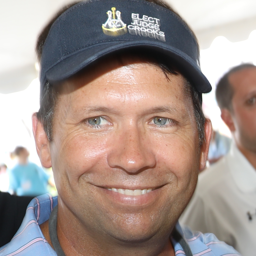

In [9]:
idx = 11
x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
x_true_s = pilimg_to_tensor(x_true_pil)
print(x_true_s.device)
print("original image", str(idx).zfill(5)+'.png')
display_as_pilimg(x_true_s)

M = x_true_s.shape[2]
N = x_true_s.shape[3]

f = 0.01
fc = 90  # cutoff frequency
n=20      # order of the filter

bf = 1/np.sqrt(1+(f/fc)**(2*n))

xi = torch.arange(M)
ind = (xi>M/2)
xi[ind] = xi[ind]-M
zeta = torch.arange(N)
ind = (zeta>N/2)
zeta[ind] = zeta[ind] - N
Xi,Zeta = torch.meshgrid(xi,zeta,indexing='ij')

bf1 = 1/torch.sqrt(1+(Xi/(M*fc/2))**(2*n)).to(device)
bf2 = 1/torch.sqrt(1+(Zeta/(N*fc/2))**(2*n)).to(device)
bf = bf1*bf2 #Le filtre est déjà dans l'espace des fréquences
s = 2 #facteur par lequel la taille de l'image est divisée. 2 est bien, 4 c'est trop.
# plt.figure(dpi=100)
# plt.plot(torch.roll(bf[0,:],125, 0))
# plt.show()

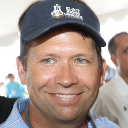

Iteration : 0 t= 999


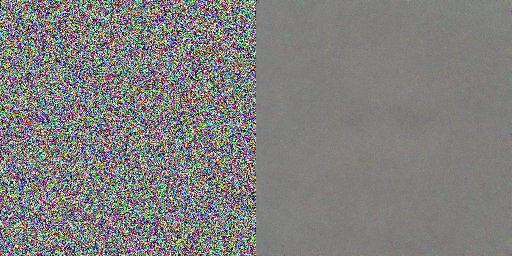

Iteration : 99 t= 900


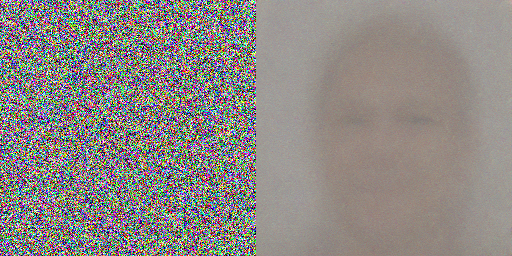

Iteration : 299 t= 700


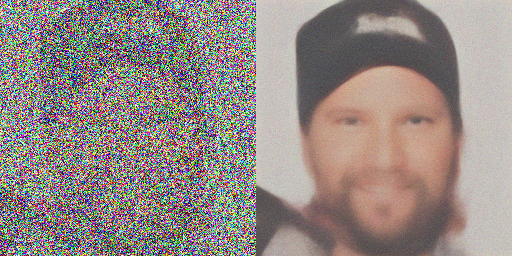

Iteration : 499 t= 500


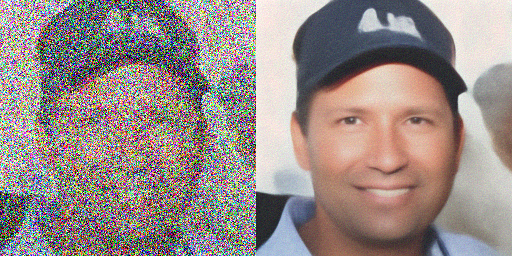

Iteration : 699 t= 300


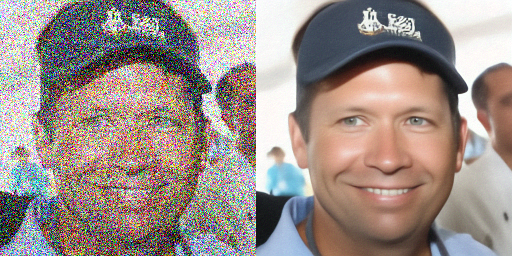

Iteration : 899 t= 100


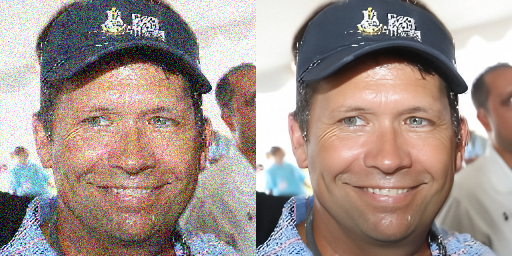

Iteration : 989 t= 10


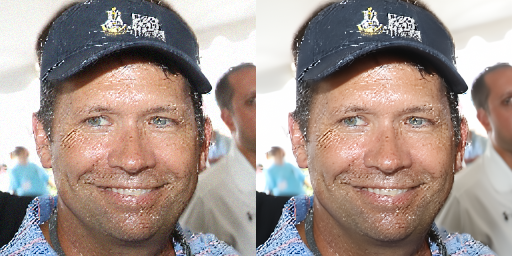

The best result is


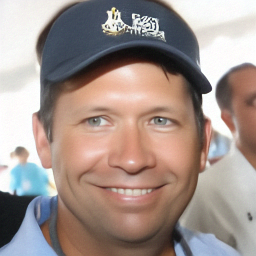

<PIL.Image.Image image mode=RGB size=256x256 at 0x7D85C968B700>


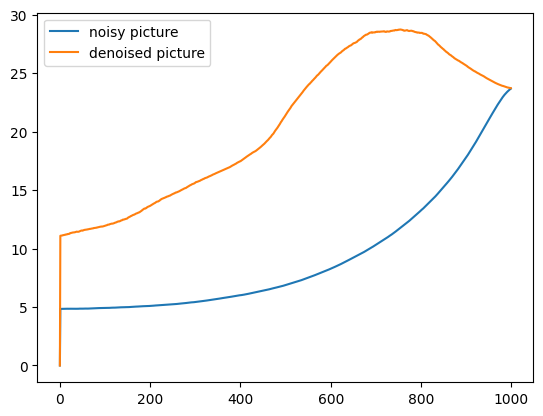

In [11]:
operator_sres = super_resolution(bf,2)

y_sup_res = operator_sres.forward(x_true_s)
display_as_pilimg(y_sup_res)

_, psnr_noisy, psnr_denoised = PIGuidance.posterior_sampling(y_sup_res, operator_sres, x_true=x_true_s, show_steps=True, name = 'Super resolution')
plt.plot(psnr_noisy, label = 'noisy picture')
plt.plot(psnr_denoised, label = 'denoised picture')
plt.legend()

print("The best result is")
print(display_as_pilimg(PIGuidance.best_result))

## Concatenation of operators

This section deals with the case where the degradation operator is a composition the ones described above. That is, it takes the form:
$$
H = H_1 \circ H_2 \circ \cdots \circ H_n.
$$

The main assumption made here is that the pseudo-inverse operator is computed by:
$$
H^\dagger \approx H_n^\dagger \circ \cdots H_2^\dagger \cdots H_1^\dagger.
$$
Note that it is rigorously false in general, even for linear and simple operators.

### Example

We take here three operators:

$H_1: \text{super resolution}$

$H_2: \text{masking}$

$H_3: \text{quantization}$

cuda:0
original image 00130.png


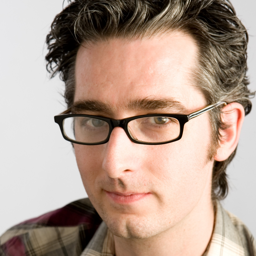

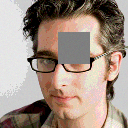

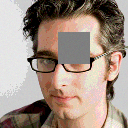

In [ ]:
idx = 130
x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
x_true_s = pilimg_to_tensor(x_true_pil)
print(x_true_s.device)
print("original image", str(idx).zfill(5)+'.png')
display_as_pilimg(x_true_s)

scale = 5

operator_sres = super_resolution(bf,2)
mask_operator = masking(mask)
quant = quantization(scale)
list_operator = [quant, mask_operator, operator_sres]

operator = concat_operator(2,list_operator)

y = operator.forward(x_true_s)
y +=  torch.randn_like(y)*.1
display_as_pilimg(y/scale)

Iteration : 0 t= 999


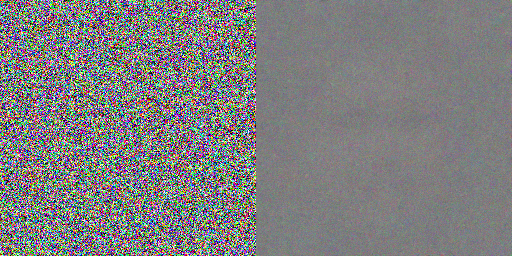

Iteration : 99 t= 900


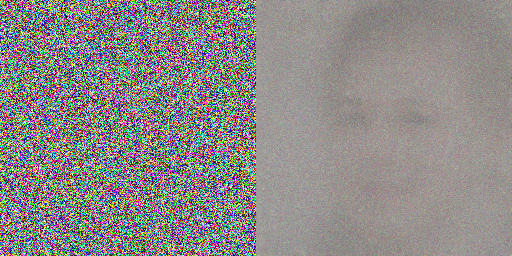

Iteration : 249 t= 750


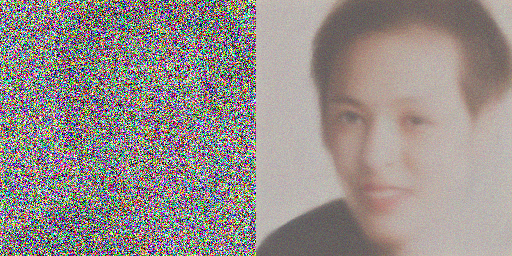

Iteration : 399 t= 600


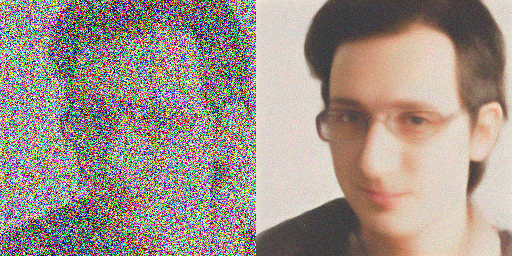

Iteration : 549 t= 450


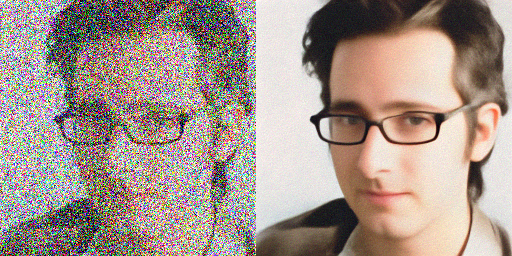

Iteration : 699 t= 300


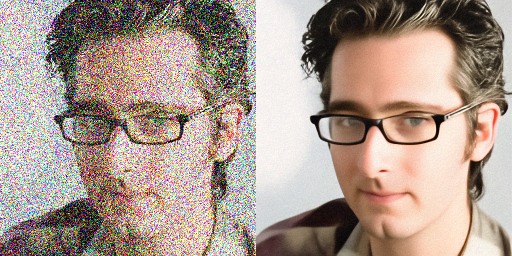

Iteration : 849 t= 150


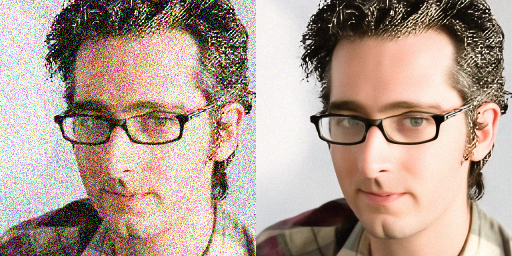

Iteration : 989 t= 10


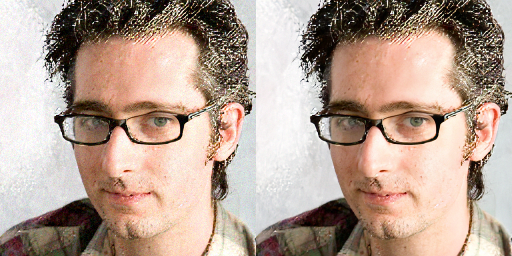

The best result is


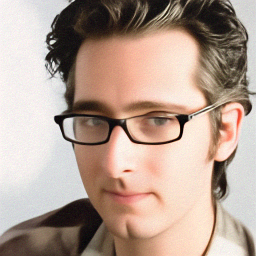

<PIL.Image.Image image mode=RGB size=256x256 at 0x7D719517DBA0>


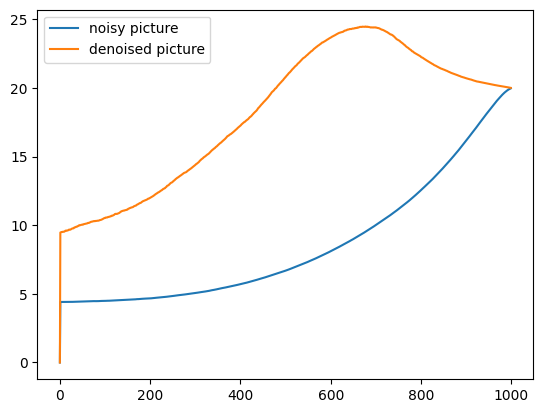

In [ ]:
_, psnr_noisy, psnr_denoised = PIGuidance.posterior_sampling(y, operator, x_true = x_true_s, show_steps=True, name = 'Mask + Super resolution')
plt.plot(psnr_noisy, label = 'noisy picture')
plt.plot(psnr_denoised, label = 'denoised picture')
plt.legend()

print("The best result is")
print(display_as_pilimg(PIGuidance.best_result))

You can see it works not so bad.